In [1]:
import os
import zarr
import random
import json
import warnings
import numpy as np
import pandas as pd
import torch.nn as nn
from pathlib import Path
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Dataset
from collections import defaultdict
import sys
import torch
import torchvision.transforms.functional as F
import random

warnings.filterwarnings("ignore")
sys.path.append("./src/")

from src.config import CFG
from src.dataloader import (
    read_zarr,
    read_info_json,
    scale_coordinates,
    create_dataset,
    create_segmentation_map,
    EziiDataset,
    drop_padding,
)
from src.network import UNet_2D, aug
from src.utils import save_images
from src.metric import score, create_cls_pos, create_cls_pos_sikii, create_df
from metric import visualize_epoch_results

In [2]:
train_dataset = EziiDataset(
    exp_names=CFG.train_exp_names,
    base_dir="../../inputs/train/",
    particles_name=CFG.particles_name,
    resolution=CFG.resolution,
    zarr_type=CFG.train_zarr_types,
    train=True,
)

valid_dataset = EziiDataset(
    exp_names=CFG.valid_exp_names,
    base_dir="../../inputs/train/",
    particles_name=CFG.particles_name,
    resolution=CFG.resolution,
    zarr_type=CFG.valid_zarr_types,
    train=True,
)

from tqdm import tqdm

train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)
train_nshuffle_loader = DataLoader(train_dataset, batch_size=1, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False)

for data in tqdm(train_dataset):
    normalized_tomogram = data["normalized_tomogram"]
    segmentation_map = data["segmentation_map"]
    break

# normalized_tomogram =
normalized_tomogram.shape[0]

[('TS_5_4', 'denoised'), ('TS_73_6', 'denoised'), ('TS_99_9', 'denoised'), ('TS_6_4', 'denoised'), ('TS_69_2', 'denoised')]
[('TS_86_3', 'denoised'), ('TS_6_6', 'denoised')]


  0%|          | 0/5 [00:00<?, ?it/s]


92

In [3]:
# torchのpadding用の関数
# torch.Size([4, 1, 158, 158]) -> torch.Size([4, 1, 160, 160])


class PadToSize(nn.Module):
    def __init__(self, resolution):
        super().__init__()
        if resolution == "0":
            self.size = 640
        elif resolution == "1":
            self.size = 320
        elif resolution == "2":
            self.size = 160

    def forward(self, x):
        return F.pad(x, (0, 0, self.size - x.shape[-1], self.size - x.shape[-2]))


# test
pad = PadToSize(CFG.resolution)
test_input = torch.randn((4, 1, 158, 158))
print(test_input.shape)
print(pad(test_input).shape)

torch.Size([4, 1, 158, 158])
torch.Size([4, 1, 320, 320])


In [4]:
model = UNet_2D().to("cuda")
model.eval()

UNet_2D(
  (model): Unet(
    (encoder): EfficientNetEncoder(
      (_conv_stem): Conv2dStaticSamePadding(
        1, 64, kernel_size=(3, 3), stride=(2, 2), bias=False
        (static_padding): ZeroPad2d((0, 1, 0, 1))
      )
      (_bn0): BatchNorm2d(64, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_blocks): ModuleList(
        (0): MBConvBlock(
          (_depthwise_conv): Conv2dStaticSamePadding(
            64, 64, kernel_size=(3, 3), stride=[1, 1], groups=64, bias=False
            (static_padding): ZeroPad2d((1, 1, 1, 1))
          )
          (_bn1): BatchNorm2d(64, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
          (_se_reduce): Conv2dStaticSamePadding(
            64, 16, kernel_size=(1, 1), stride=(1, 1)
            (static_padding): Identity()
          )
          (_se_expand): Conv2dStaticSamePadding(
            16, 64, kernel_size=(1, 1), stride=(1, 1)
            (static_padding): Identit

In [5]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch

# サンプルデータ
num_classes = len(CFG.particles_name)  # クラス数
colors = plt.cm.tab10(
    np.arange(len(CFG.particles_name))
)  # "tab10" カラーマップから色を取得

# ListedColormap を作成
class_colormap = ListedColormap(colors)


# カラーバー付きプロット
def plot_with_colormap(data, title, original_tomogram):
    masked_data = np.ma.masked_where(data <= 0, data)  # クラス0をマスク
    plt.imshow(original_tomogram, cmap="gray")
    im = plt.imshow(masked_data, cmap=class_colormap)
    plt.title(title)
    plt.axis("off")
    return im

In [6]:
class SegmentationLoss(nn.Module):
    def __init__(self, criterion):
        super().__init__()
        self.softmax = nn.Softmax(dim=1)
        self.criterion = criterion

    def forward(self, output, target):
        # output: (batch, cls, 160, 160)
        # target: (batch, 160, 160)

        # output, (batch, 160, 160, cls) -> (batch, 160, 160, cls)
        output = output.permute(0, 2, 3, 1)
        output = output.reshape(-1, output.shape[-1])  # (batch*160*160, cls)

        # target, (batch, 160, 160) -> (batch*160*160)
        target = target.reshape(-1)

        loss = self.criterion(output, target)
        return loss

Train-Epoch: 0, Loss: 0.6143329699240301: 100%|██████████| 460/460 [00:54<00:00,  8.39it/s]
Train-nshuffle-Epoch: 0, Loss: 0.6739341246288107: 100%|██████████| 460/460 [00:21<00:00, 21.76it/s]


EPOCH: 0, TRAIN_SCORE: 0.0013530190923093936


Valid-Epoch: 0, Loss: 0.5593497507355135: 100%|██████████| 184/184 [00:09<00:00, 19.96it/s]


EPOCH: 0, VALID_SCORE: 0.004865701556697296


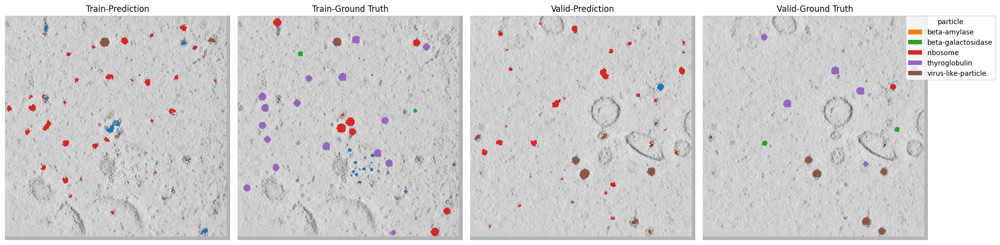

Train-Epoch: 1, Loss: 0.5194311026645744: 100%|██████████| 460/460 [00:53<00:00,  8.54it/s] 
Train-nshuffle-Epoch: 1, Loss: 0.4412280643439811: 100%|██████████| 460/460 [00:19<00:00, 23.51it/s] 


EPOCH: 1, TRAIN_SCORE: 0.002989550690233861


Valid-Epoch: 1, Loss: 0.4680031044003756: 100%|██████████| 184/184 [00:08<00:00, 21.31it/s] 


EPOCH: 1, VALID_SCORE: 0.003871219417706516


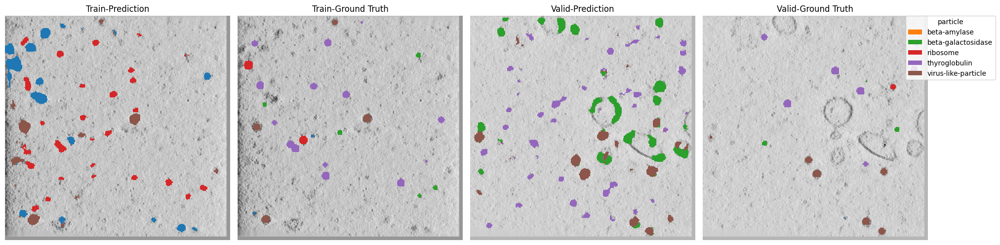

Train-Epoch: 2, Loss: 0.4624855432983326: 100%|██████████| 460/460 [00:53<00:00,  8.58it/s] 
Train-nshuffle-Epoch: 2, Loss: 0.3188426126766464: 100%|██████████| 460/460 [00:20<00:00, 22.22it/s] 


EPOCH: 2, TRAIN_SCORE: 0.0013336918652965637


Valid-Epoch: 2, Loss: 0.3538130604783478: 100%|██████████| 184/184 [00:08<00:00, 22.25it/s] 


EPOCH: 2, VALID_SCORE: 0.0020003405073733107


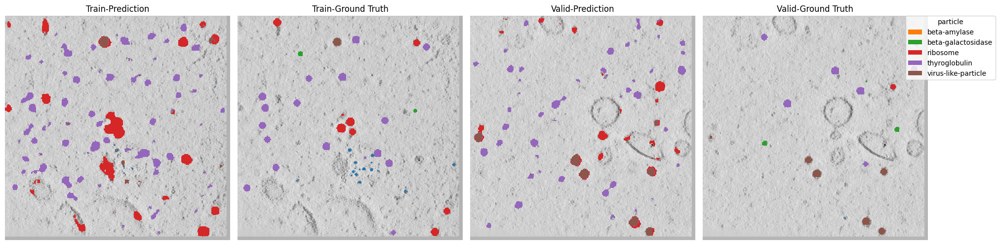

Train-Epoch: 3, Loss: 0.4396836833420979: 100%|██████████| 460/460 [00:55<00:00,  8.35it/s] 
Train-nshuffle-Epoch: 3, Loss: 0.3517466815431481: 100%|██████████| 460/460 [00:20<00:00, 22.87it/s] 


EPOCH: 3, TRAIN_SCORE: 0.003554749338646787


Valid-Epoch: 3, Loss: 0.4402417937982018: 100%|██████████| 184/184 [00:08<00:00, 22.63it/s] 


EPOCH: 3, VALID_SCORE: 0.006214703352658762


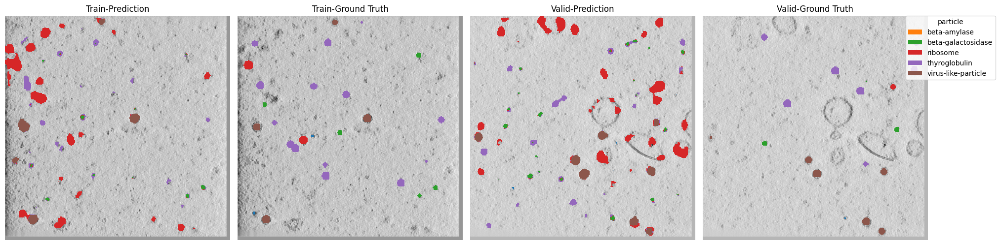

Train-Epoch: 4, Loss: 0.3943061417414118: 100%|██████████| 460/460 [00:55<00:00,  8.32it/s] 
Train-nshuffle-Epoch: 4, Loss: 0.3404718592762947: 100%|██████████| 460/460 [00:20<00:00, 22.49it/s] 


EPOCH: 4, TRAIN_SCORE: 0.003346901383977481


Valid-Epoch: 4, Loss: 0.41281080478802323: 100%|██████████| 184/184 [00:08<00:00, 21.96it/s]


EPOCH: 4, VALID_SCORE: 0.00618395216497705


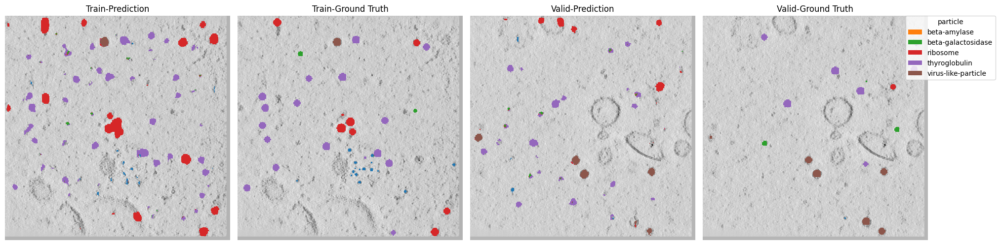

Train-Epoch: 5, Loss: 0.3791929431826524: 100%|██████████| 460/460 [00:54<00:00,  8.46it/s] 
Train-nshuffle-Epoch: 5, Loss: 0.39240885277319215: 100%|██████████| 460/460 [00:19<00:00, 23.09it/s]


EPOCH: 5, TRAIN_SCORE: 0.0031088864973140102


Valid-Epoch: 5, Loss: 0.5134603408286753: 100%|██████████| 184/184 [00:08<00:00, 20.99it/s] 


EPOCH: 5, VALID_SCORE: 0.006681027542942031


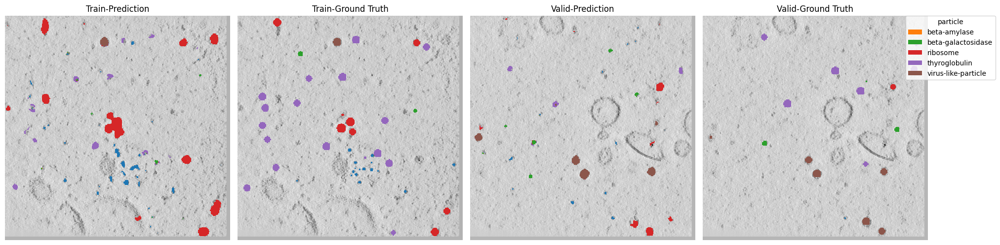

Train-Epoch: 6, Loss: 0.3633366208523512: 100%|██████████| 460/460 [00:55<00:00,  8.33it/s] 
Train-nshuffle-Epoch: 6, Loss: 0.39653648431210414: 100%|██████████| 460/460 [00:20<00:00, 22.29it/s]


EPOCH: 6, TRAIN_SCORE: 0.004205703631303915


Valid-Epoch: 6, Loss: 0.5319377368154086: 100%|██████████| 184/184 [00:07<00:00, 23.23it/s] 


EPOCH: 6, VALID_SCORE: 0.009097497819962538


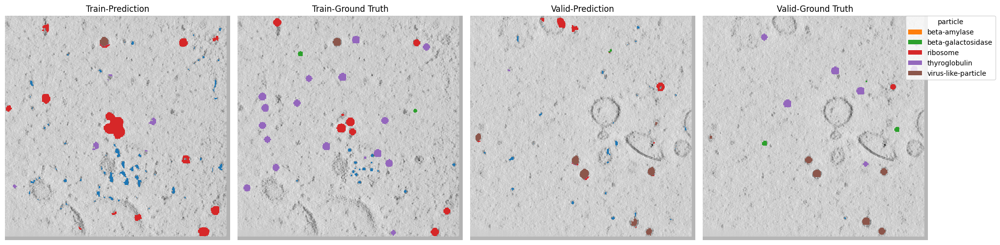

Train-Epoch: 7, Loss: 0.34493747937857455: 100%|██████████| 460/460 [00:55<00:00,  8.36it/s]
Train-nshuffle-Epoch: 7, Loss: 0.32235434630318827: 100%|██████████| 460/460 [00:19<00:00, 23.32it/s]


EPOCH: 7, TRAIN_SCORE: 0.00641932611328674


Valid-Epoch: 7, Loss: 0.4865624030404117: 100%|██████████| 184/184 [00:08<00:00, 20.86it/s] 


EPOCH: 7, VALID_SCORE: 0.004207217729495755


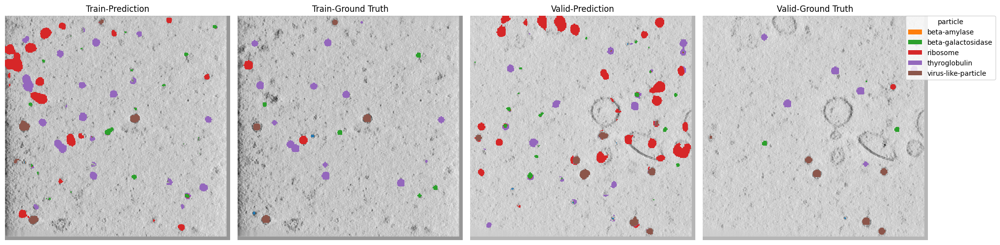

Train-nshuffle-Epoch: 8, Loss: 0.428887894741543: 100%|██████████| 460/460 [00:20<00:00, 22.64it/s]  


EPOCH: 8, TRAIN_SCORE: 0.0038552784659843372


Valid-Epoch: 8, Loss: 0.6589985658293185: 100%|██████████| 184/184 [00:08<00:00, 22.00it/s]


EPOCH: 8, VALID_SCORE: 0.0074164088640130904


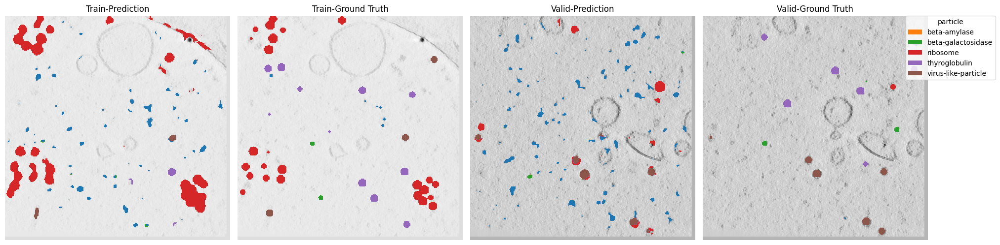

Train-Epoch: 9, Loss: 0.36666071645146153: 100%|██████████| 460/460 [00:54<00:00,  8.41it/s]
Train-nshuffle-Epoch: 9, Loss: 0.3046735652762911: 100%|██████████| 460/460 [00:20<00:00, 22.59it/s] 


EPOCH: 9, TRAIN_SCORE: 0.004181947784005336


Valid-Epoch: 9, Loss: 0.4677422196280373: 100%|██████████| 184/184 [00:08<00:00, 22.92it/s] 


EPOCH: 9, VALID_SCORE: 0.005965332894680754


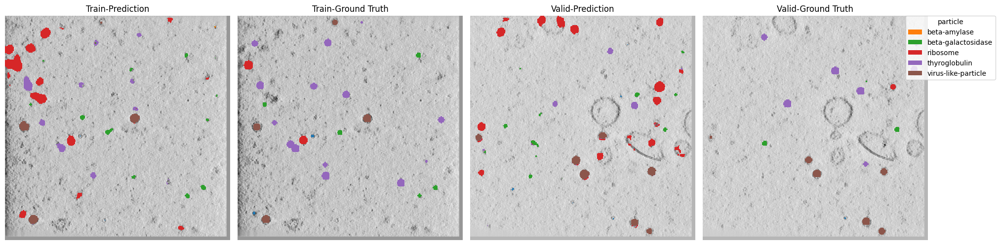

Train-Epoch: 10, Loss: 0.30331080478373107: 100%|██████████| 460/460 [00:55<00:00,  8.25it/s]
Train-nshuffle-Epoch: 10, Loss: 0.4870667864042132: 100%|██████████| 460/460 [00:21<00:00, 21.53it/s] 


EPOCH: 10, TRAIN_SCORE: 0.006327006579185274


Valid-Epoch: 10, Loss: 0.7655223052462806: 100%|██████████| 184/184 [00:08<00:00, 21.94it/s]


EPOCH: 10, VALID_SCORE: 0.00717705119760779


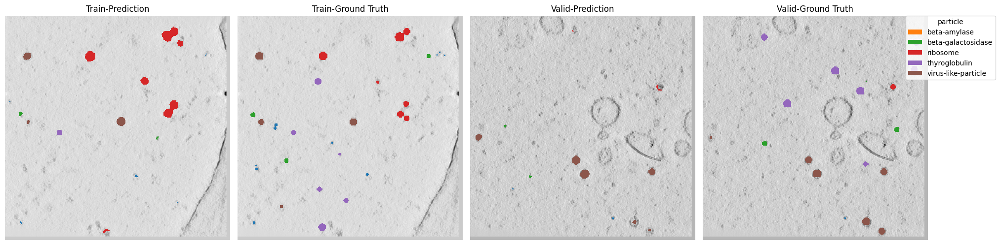

Train-Epoch: 11, Loss: 0.32968400922887353: 100%|██████████| 460/460 [00:53<00:00,  8.55it/s]
Train-nshuffle-Epoch: 11, Loss: 0.3969856072905595: 100%|██████████| 460/460 [00:20<00:00, 22.58it/s] 


EPOCH: 11, TRAIN_SCORE: 0.0044602123098575934


Valid-Epoch: 11, Loss: 0.7816102489444386: 100%|██████████| 184/184 [00:08<00:00, 22.53it/s]


EPOCH: 11, VALID_SCORE: 0.002676111767020858


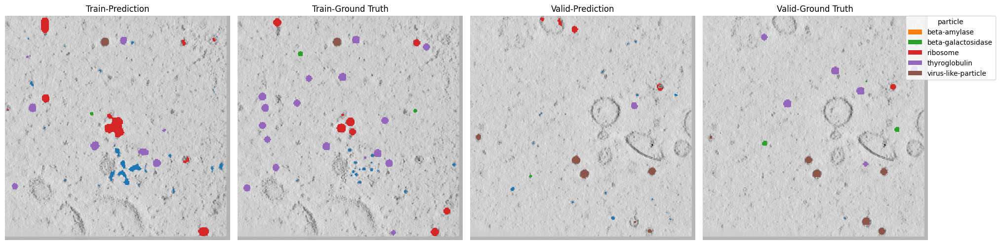

Train-Epoch: 12, Loss: 0.3302568972191733: 100%|██████████| 460/460 [00:55<00:00,  8.33it/s] 
Train-nshuffle-Epoch: 12, Loss: 0.2522007083155863: 100%|██████████| 460/460 [00:20<00:00, 22.62it/s] 


EPOCH: 12, TRAIN_SCORE: 0.002873216153616163


Valid-Epoch: 12, Loss: 0.6543993018162639: 100%|██████████| 184/184 [00:08<00:00, 22.31it/s]


EPOCH: 12, VALID_SCORE: 0.003590465222130482


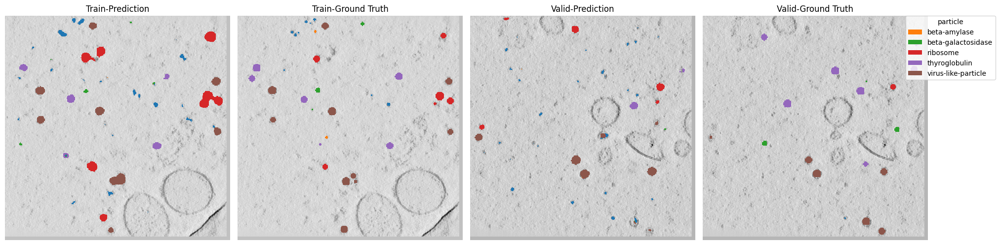

Train-Epoch: 13, Loss: 0.34025553871229614: 100%|██████████| 460/460 [00:55<00:00,  8.30it/s]
Train-nshuffle-Epoch: 13, Loss: 0.3977874930381127: 100%|██████████| 460/460 [00:20<00:00, 22.47it/s] 


EPOCH: 13, TRAIN_SCORE: 0.004681814186017206


Valid-Epoch: 13, Loss: 0.6858257826053255: 100%|██████████| 184/184 [00:08<00:00, 21.09it/s]


EPOCH: 13, VALID_SCORE: 0.007352136952540969


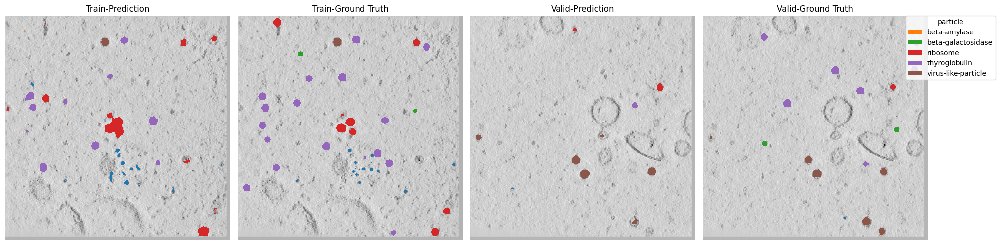

Train-Epoch: 14, Loss: 0.32923327764172267: 100%|██████████| 460/460 [00:52<00:00,  8.79it/s]
Train-nshuffle-Epoch: 14, Loss: 0.44639395004057364: 100%|██████████| 460/460 [00:20<00:00, 22.52it/s]


EPOCH: 14, TRAIN_SCORE: 0.007259497511164425


Valid-Epoch: 14, Loss: 0.6805779750499389: 100%|██████████| 184/184 [00:08<00:00, 22.47it/s]


EPOCH: 14, VALID_SCORE: 0.008307490107148013


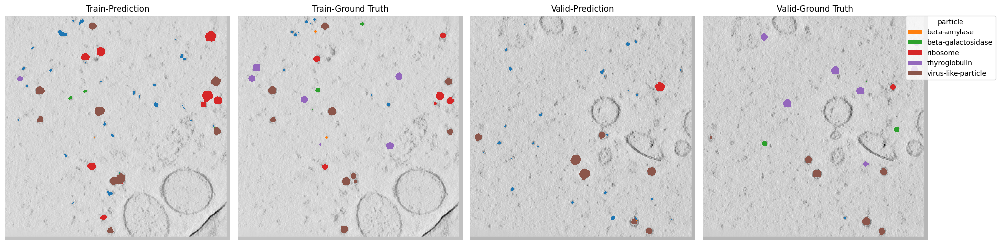

Train-Epoch: 15, Loss: 0.30208700628566515: 100%|██████████| 460/460 [00:53<00:00,  8.57it/s]
Train-nshuffle-Epoch: 15, Loss: 0.5833219067031599: 100%|██████████| 460/460 [00:19<00:00, 23.50it/s]


EPOCH: 15, TRAIN_SCORE: 0.003566475618655018


Valid-Epoch: 15, Loss: 0.8741242807237026: 100%|██████████| 184/184 [00:07<00:00, 23.24it/s]


EPOCH: 15, VALID_SCORE: 0.012625920889486206


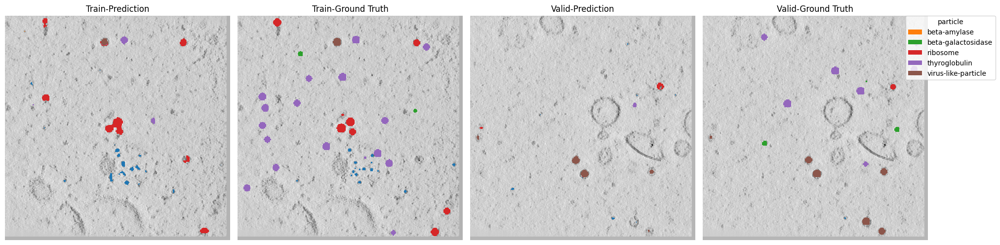

Train-Epoch: 16, Loss: 0.3380016911957089: 100%|██████████| 460/460 [00:53<00:00,  8.55it/s] 
Train-nshuffle-Epoch: 16, Loss: 0.3471864737003394: 100%|██████████| 460/460 [00:19<00:00, 23.50it/s] 


EPOCH: 16, TRAIN_SCORE: 0.0038870882541089855


Valid-Epoch: 16, Loss: 0.5253300579548206: 100%|██████████| 184/184 [00:08<00:00, 22.39it/s] 


EPOCH: 16, VALID_SCORE: 0.0036525011395785708


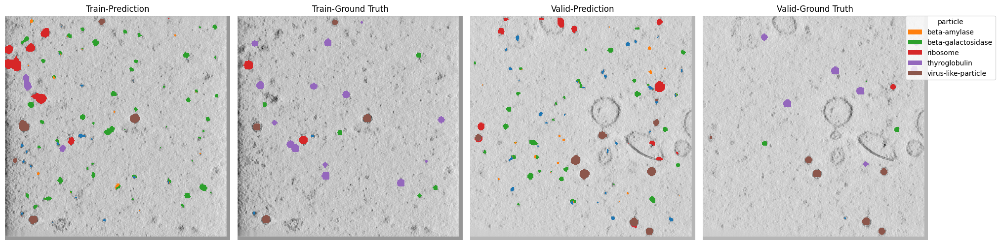

Train-Epoch: 17, Loss: 0.3591458090429154: 100%|██████████| 460/460 [00:53<00:00,  8.57it/s] 
Train-nshuffle-Epoch: 17, Loss: 0.26996875031162865: 100%|██████████| 460/460 [00:19<00:00, 23.63it/s]


EPOCH: 17, TRAIN_SCORE: 0.00360034395880682


Valid-Epoch: 17, Loss: 0.575462765303319: 100%|██████████| 184/184 [00:08<00:00, 22.14it/s] 


EPOCH: 17, VALID_SCORE: 0.006350828477045732


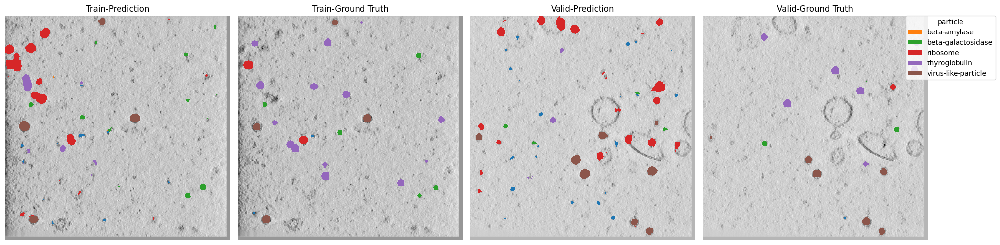

Train-Epoch: 18, Loss: 0.3200060416417925: 100%|██████████| 460/460 [00:52<00:00,  8.75it/s] 
Train-nshuffle-Epoch: 18, Loss: 0.3696255252251159: 100%|██████████| 460/460 [00:19<00:00, 23.78it/s] 


EPOCH: 18, TRAIN_SCORE: 0.00422214340600613


Valid-Epoch: 18, Loss: 0.6603293598670027: 100%|██████████| 184/184 [00:08<00:00, 21.93it/s]


EPOCH: 18, VALID_SCORE: 0.004972130003756891


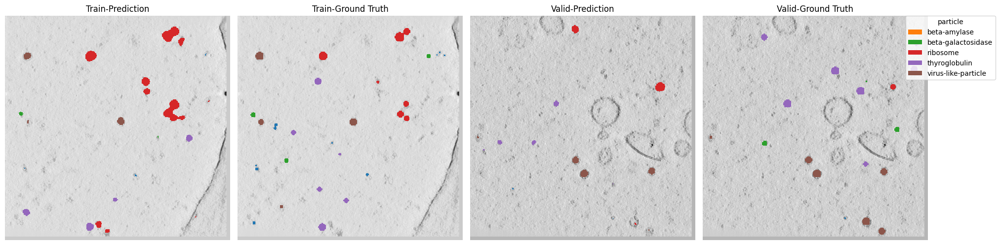

Train-Epoch: 19, Loss: 0.34119167158926794: 100%|██████████| 460/460 [00:54<00:00,  8.47it/s]
Train-nshuffle-Epoch: 19, Loss: 7.447629491142605: 100%|██████████| 460/460 [00:20<00:00, 22.02it/s] 


EPOCH: 19, TRAIN_SCORE: 0.006818501473392513


Valid-Epoch: 19, Loss: 8.621981685576232: 100%|██████████| 184/184 [00:08<00:00, 22.40it/s]


EPOCH: 19, VALID_SCORE: 0.007834101382488478


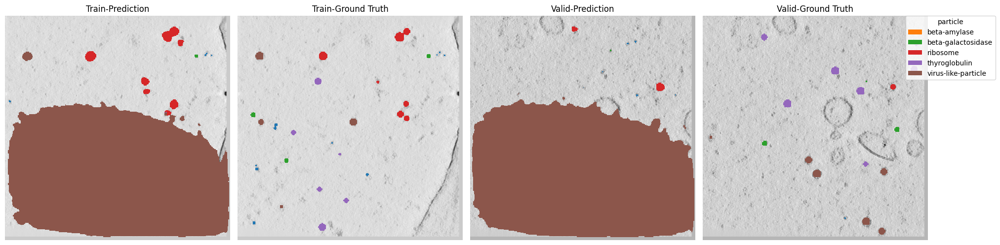

Train-Epoch: 20, Loss: 0.3418767875607085: 100%|██████████| 460/460 [00:53<00:00,  8.53it/s] 
Train-nshuffle-Epoch: 20, Loss: 0.6398818385260908: 100%|██████████| 460/460 [00:20<00:00, 22.64it/s]


EPOCH: 20, TRAIN_SCORE: 0.0055270692823557194


Valid-Epoch: 20, Loss: 0.880448568450368: 100%|██████████| 184/184 [00:08<00:00, 22.23it/s] 


EPOCH: 20, VALID_SCORE: 0.00994700690369353


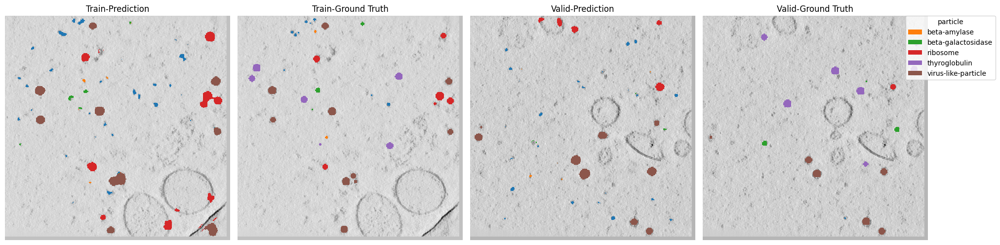

Train-Epoch: 21, Loss: 0.327567448166361: 100%|██████████| 460/460 [00:55<00:00,  8.36it/s]  
Train-nshuffle-Epoch: 21, Loss: 0.5159083814319709: 100%|██████████| 460/460 [00:19<00:00, 23.01it/s] 


EPOCH: 21, TRAIN_SCORE: 0.004517466332351587


Valid-Epoch: 21, Loss: 0.7776391634049461: 100%|██████████| 184/184 [00:08<00:00, 22.34it/s]


EPOCH: 21, VALID_SCORE: 0.008950781056702599


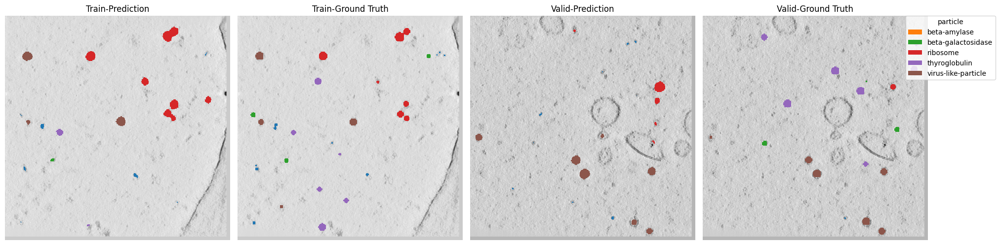

Train-Epoch: 22, Loss: 0.36649106992611097: 100%|██████████| 460/460 [00:52<00:00,  8.81it/s]
Train-nshuffle-Epoch: 22, Loss: 0.4569405830910672: 100%|██████████| 460/460 [00:19<00:00, 23.54it/s] 


EPOCH: 22, TRAIN_SCORE: 0.004209412835921956


Valid-Epoch: 22, Loss: 0.6867038130800686: 100%|██████████| 184/184 [00:08<00:00, 22.37it/s]


EPOCH: 22, VALID_SCORE: 0.005247696872249319


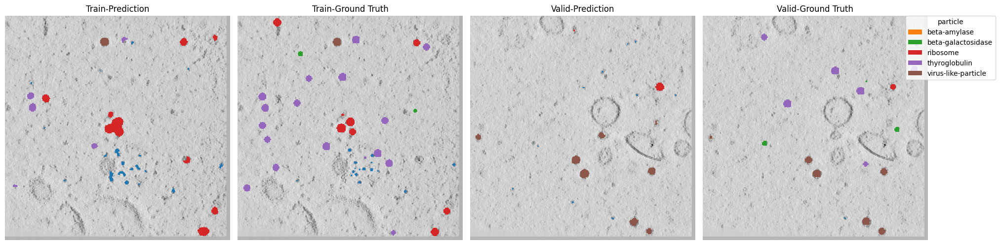

Train-Epoch: 23, Loss: 0.3342587277283082: 100%|██████████| 460/460 [00:54<00:00,  8.42it/s] 
Train-nshuffle-Epoch: 23, Loss: 0.37932557967369973: 100%|██████████| 460/460 [00:20<00:00, 22.81it/s]


EPOCH: 23, TRAIN_SCORE: 0.00295014926602645


Valid-Epoch: 23, Loss: 0.6424471123305999: 100%|██████████| 184/184 [00:08<00:00, 22.44it/s]


EPOCH: 23, VALID_SCORE: 0.004416322016050962


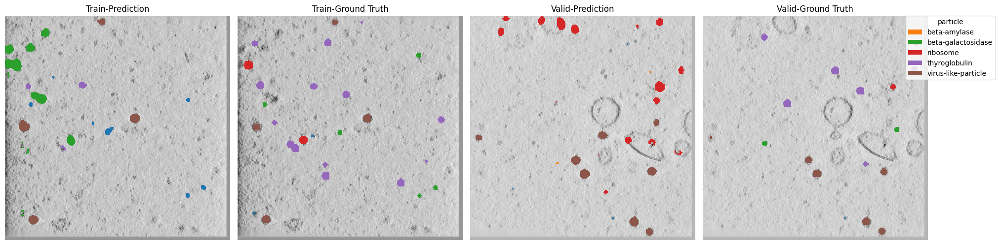

Train-Epoch: 24, Loss: 0.29957475007774875: 100%|██████████| 460/460 [00:54<00:00,  8.39it/s]
Train-nshuffle-Epoch: 24, Loss: 0.23333578021468027: 100%|██████████| 460/460 [00:20<00:00, 22.89it/s]


EPOCH: 24, TRAIN_SCORE: 0.0029127021888654824


Valid-Epoch: 24, Loss: 0.6019162117787029: 100%|██████████| 184/184 [00:08<00:00, 22.54it/s]


EPOCH: 24, VALID_SCORE: 0.010571524058496406


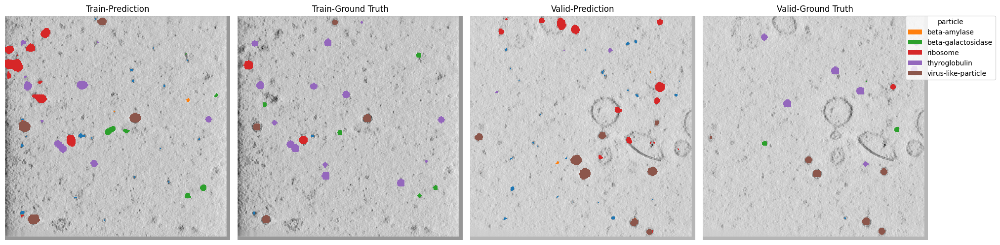

Train-Epoch: 25, Loss: 0.3235355998278069: 100%|██████████| 460/460 [00:54<00:00,  8.37it/s] 
Train-nshuffle-Epoch: 25, Loss: 0.3664266121492762: 100%|██████████| 460/460 [00:19<00:00, 23.19it/s] 


EPOCH: 25, TRAIN_SCORE: 0.002847772355154785


Valid-Epoch: 25, Loss: 0.6916929220719992: 100%|██████████| 184/184 [00:08<00:00, 22.37it/s]


EPOCH: 25, VALID_SCORE: 0.007418148301042683


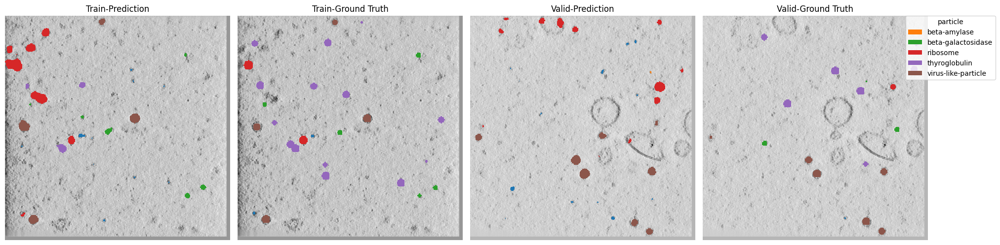

Train-Epoch: 26, Loss: 0.26391889994012435: 100%|██████████| 460/460 [00:51<00:00,  8.93it/s]
Train-nshuffle-Epoch: 26, Loss: 0.2725289148804934: 100%|██████████| 460/460 [00:20<00:00, 22.32it/s] 


EPOCH: 26, TRAIN_SCORE: 0.0038890626995302163


Valid-Epoch: 26, Loss: 0.6823799729995106: 100%|██████████| 184/184 [00:08<00:00, 21.92it/s]


EPOCH: 26, VALID_SCORE: 0.008104940359610183


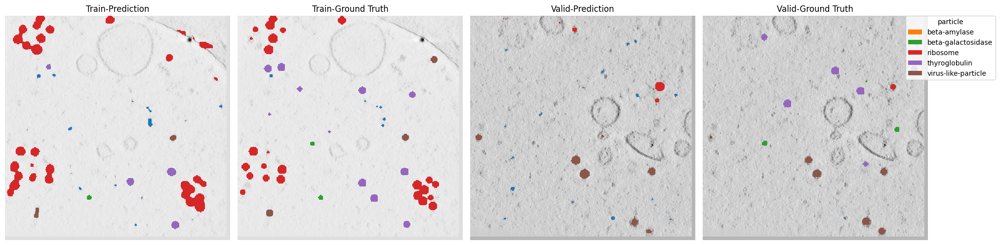

Train-Epoch: 27, Loss: 0.2597175868359678: 100%|██████████| 460/460 [00:54<00:00,  8.47it/s] 
Train-nshuffle-Epoch: 27, Loss: 0.34742119144648315: 100%|██████████| 460/460 [00:20<00:00, 22.88it/s]


EPOCH: 27, TRAIN_SCORE: 0.0036645608314807864


Valid-Epoch: 27, Loss: 0.6251320022198817: 100%|██████████| 184/184 [00:08<00:00, 20.92it/s]


EPOCH: 27, VALID_SCORE: 0.004665408928799914


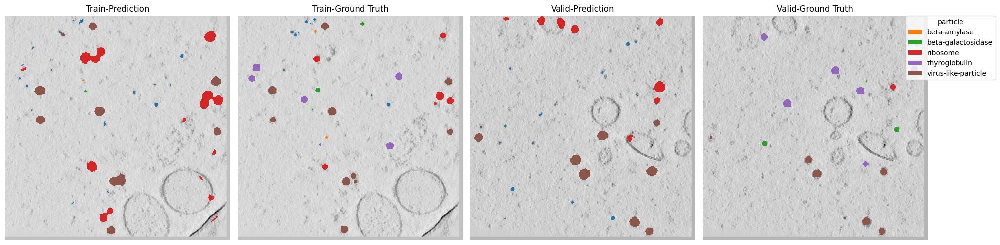

Train-Epoch: 28, Loss: 0.2999076573102249: 100%|██████████| 460/460 [00:51<00:00,  8.92it/s] 
Train-nshuffle-Epoch: 28, Loss: 0.5349946392457122: 100%|██████████| 460/460 [00:20<00:00, 22.66it/s] 


EPOCH: 28, TRAIN_SCORE: 0.008969238866913563


Valid-Epoch: 28, Loss: 0.8242080122758837: 100%|██████████| 184/184 [00:08<00:00, 21.35it/s]


EPOCH: 28, VALID_SCORE: 0.004348382146054483


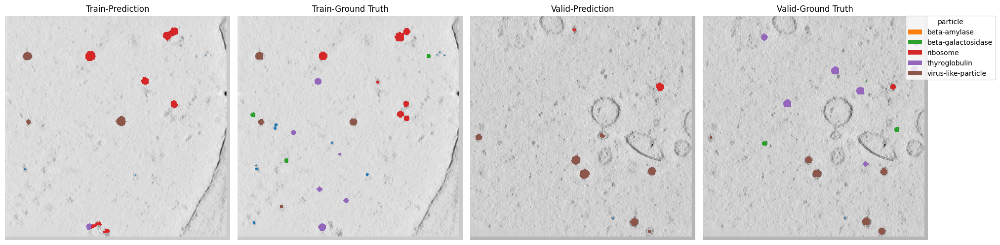

Train-Epoch: 29, Loss: 0.2870303499476944: 100%|██████████| 460/460 [00:51<00:00,  9.00it/s] 
Train-nshuffle-Epoch: 29, Loss: 0.519505967458953: 100%|██████████| 460/460 [00:19<00:00, 23.21it/s]  


EPOCH: 29, TRAIN_SCORE: 0.006328979310988886


Valid-Epoch: 29, Loss: 0.7973773775257819: 100%|██████████| 184/184 [00:08<00:00, 22.86it/s]


EPOCH: 29, VALID_SCORE: 0.003952109729164245


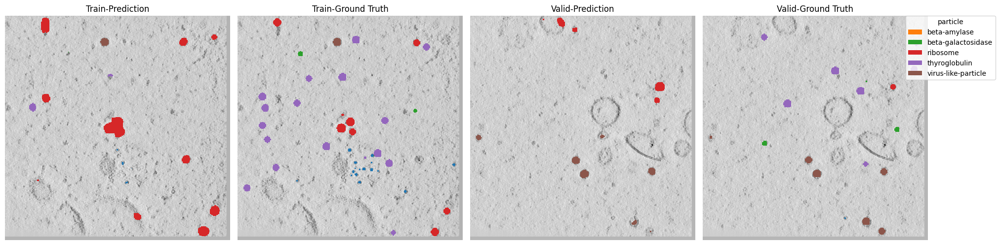

Train-Epoch: 30, Loss: 0.31523716515841205: 100%|██████████| 460/460 [00:52<00:00,  8.74it/s]
Train-nshuffle-Epoch: 30, Loss: 0.5767243699130157: 100%|██████████| 460/460 [00:20<00:00, 23.00it/s]


EPOCH: 30, TRAIN_SCORE: 0.005193601404660957


Valid-Epoch: 30, Loss: 0.8938342823808931: 100%|██████████| 184/184 [00:08<00:00, 22.52it/s]


EPOCH: 30, VALID_SCORE: 0.004287240887200785


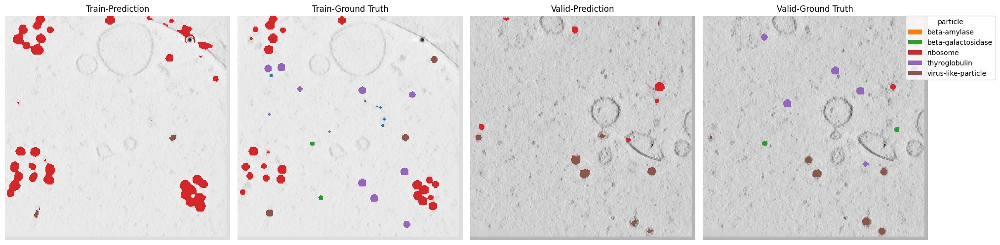

Train-Epoch: 31, Loss: 0.25622589596213124: 100%|██████████| 460/460 [00:51<00:00,  8.95it/s]
Train-nshuffle-Epoch: 31, Loss: 0.35402492903496907: 100%|██████████| 460/460 [00:20<00:00, 22.74it/s]


EPOCH: 31, TRAIN_SCORE: 0.0033603993215645563


Valid-Epoch: 31, Loss: 0.7072174220305422: 100%|██████████| 184/184 [00:08<00:00, 21.76it/s]


EPOCH: 31, VALID_SCORE: 0.004891690954106529


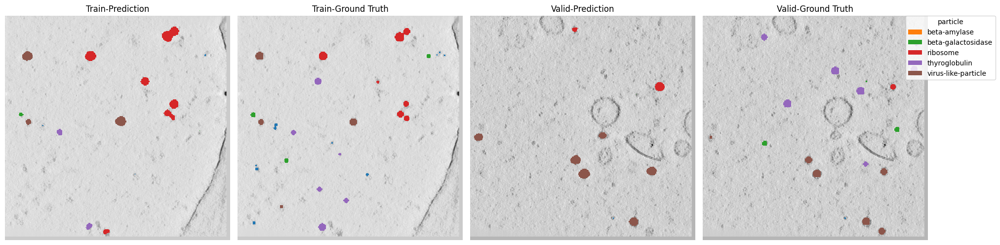

Train-Epoch: 32, Loss: 0.289198924093406: 100%|██████████| 460/460 [00:51<00:00,  8.89it/s]  
Train-nshuffle-Epoch: 32, Loss: 0.40638110584214976: 100%|██████████| 460/460 [00:19<00:00, 23.25it/s]


EPOCH: 32, TRAIN_SCORE: 0.004234722078008254


Valid-Epoch: 32, Loss: 0.7238864402651138: 100%|██████████| 184/184 [00:09<00:00, 19.94it/s]


EPOCH: 32, VALID_SCORE: 0.002323201129237741


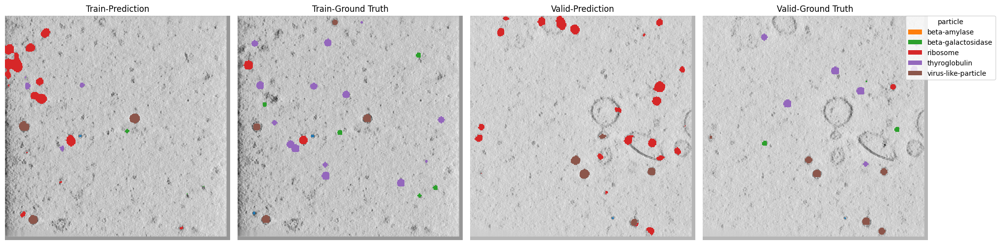

Train-Epoch: 33, Loss: 0.3213410629081013: 100%|██████████| 460/460 [00:51<00:00,  8.97it/s] 
Train-nshuffle-Epoch: 33, Loss: 0.47271287124199063: 100%|██████████| 460/460 [00:19<00:00, 23.39it/s]


EPOCH: 33, TRAIN_SCORE: 0.005338563193625847


Valid-Epoch: 33, Loss: 0.8412588896007156: 100%|██████████| 184/184 [00:08<00:00, 22.41it/s]


EPOCH: 33, VALID_SCORE: 0.005905389503412568


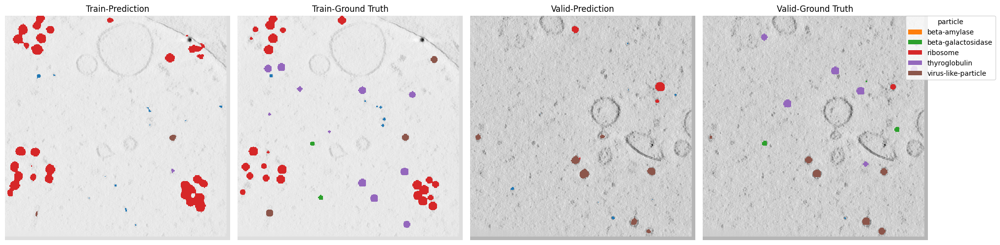

Train-Epoch: 34, Loss: 0.27718073225974954: 100%|██████████| 460/460 [00:53<00:00,  8.65it/s]
Train-nshuffle-Epoch: 34, Loss: 0.5932468281168005: 100%|██████████| 460/460 [00:19<00:00, 23.83it/s]


EPOCH: 34, TRAIN_SCORE: 0.002250864692876809


Valid-Epoch: 34, Loss: 0.9253283812178542: 100%|██████████| 184/184 [00:08<00:00, 22.42it/s]


EPOCH: 34, VALID_SCORE: 0.002710763919059529


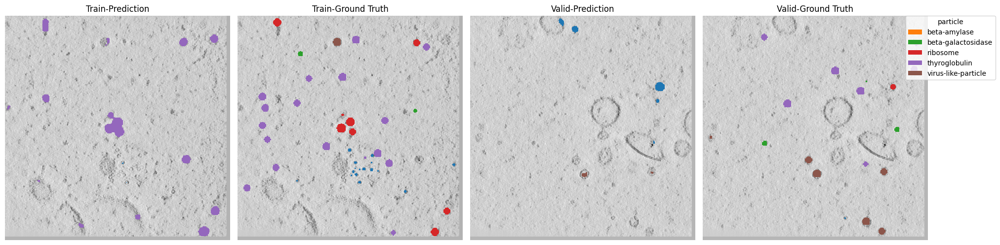

Train-Epoch: 35, Loss: 0.285196022980887: 100%|██████████| 460/460 [00:51<00:00,  8.85it/s]  
Train-nshuffle-Epoch: 35, Loss: 0.33790736619545064: 100%|██████████| 460/460 [00:20<00:00, 22.75it/s]


EPOCH: 35, TRAIN_SCORE: 0.003414795755719921


Valid-Epoch: 35, Loss: 0.6374534993715908: 100%|██████████| 184/184 [00:08<00:00, 21.41it/s]


EPOCH: 35, VALID_SCORE: 0.00682998696733549


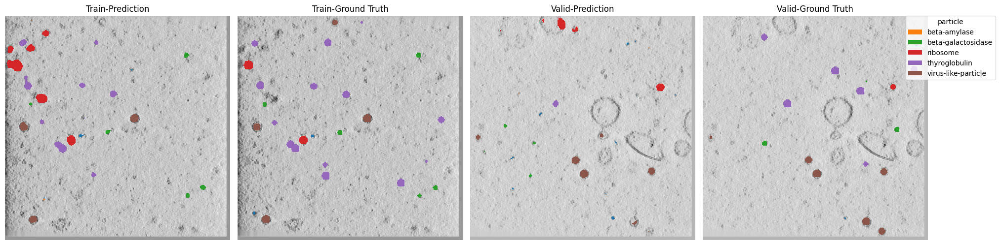

Train-Epoch: 36, Loss: 0.28389485536001463: 100%|██████████| 460/460 [00:51<00:00,  8.99it/s]
Train-nshuffle-Epoch: 36, Loss: 0.5624769179717354: 100%|██████████| 460/460 [00:19<00:00, 23.69it/s] 


EPOCH: 36, TRAIN_SCORE: 0.00325576873473985


Valid-Epoch: 36, Loss: 0.9779179080834856: 100%|██████████| 184/184 [00:08<00:00, 22.66it/s]


EPOCH: 36, VALID_SCORE: 0.0024140869071286567


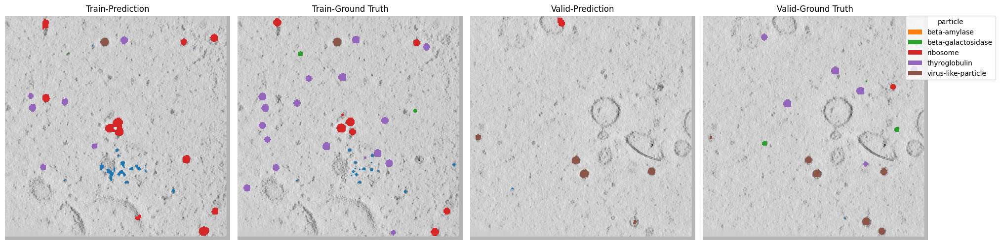

Train-Epoch: 37, Loss: 0.25765725227994035: 100%|██████████| 460/460 [00:52<00:00,  8.83it/s]
Train-nshuffle-Epoch: 37, Loss: 0.5015960954858557: 100%|██████████| 460/460 [00:19<00:00, 23.67it/s] 


EPOCH: 37, TRAIN_SCORE: 0.004384766388279416


Valid-Epoch: 37, Loss: 0.7821763768670675: 100%|██████████| 184/184 [00:08<00:00, 21.48it/s]


EPOCH: 37, VALID_SCORE: 0.0014894642309545715


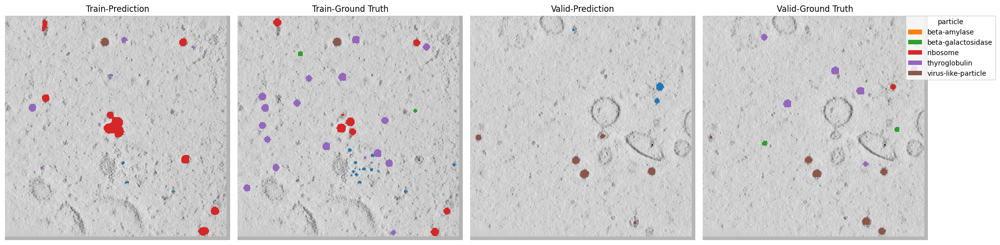

Train-Epoch: 38, Loss: 0.22792707255803574: 100%|██████████| 460/460 [00:53<00:00,  8.55it/s]
Train-nshuffle-Epoch: 38, Loss: 0.49798241872542903: 100%|██████████| 460/460 [00:20<00:00, 22.68it/s]


EPOCH: 38, TRAIN_SCORE: 0.003605611293087009


Valid-Epoch: 38, Loss: 0.9316235468874726: 100%|██████████| 184/184 [00:08<00:00, 20.75it/s]


EPOCH: 38, VALID_SCORE: 0.008062835661669557


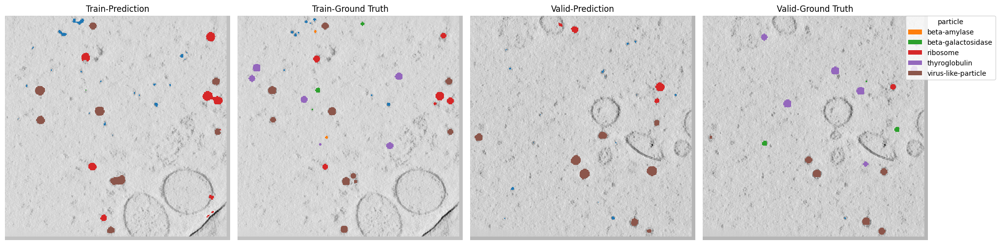

Train-Epoch: 39, Loss: 0.28909554755487277: 100%|██████████| 460/460 [00:50<00:00,  9.03it/s]
Train-nshuffle-Epoch: 39, Loss: 0.5837901955875365: 100%|██████████| 460/460 [00:20<00:00, 22.88it/s]


EPOCH: 39, TRAIN_SCORE: 0.006035236280208318


Valid-Epoch: 39, Loss: 0.9139170279402448: 100%|██████████| 184/184 [00:08<00:00, 21.79it/s]


EPOCH: 39, VALID_SCORE: 0.0033800576598071383


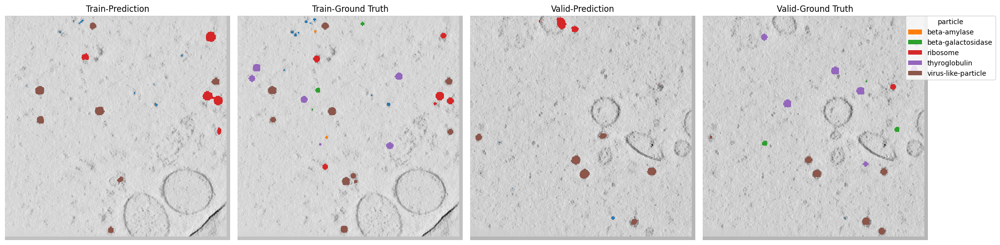

Train-Epoch: 40, Loss: 0.3109460715239908: 100%|██████████| 460/460 [00:50<00:00,  9.15it/s] 
Train-nshuffle-Epoch: 40, Loss: 1.474963985496889: 100%|██████████| 460/460 [00:20<00:00, 22.23it/s] 


EPOCH: 40, TRAIN_SCORE: 0.008988872426211022


Valid-Epoch: 40, Loss: 1.5120938899724379: 100%|██████████| 184/184 [00:08<00:00, 22.01it/s]


EPOCH: 40, VALID_SCORE: 0.0015678317808724524


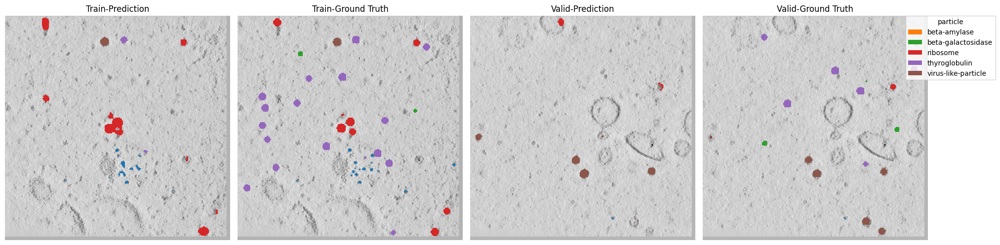

Train-Epoch: 41, Loss: 0.29263363755156246: 100%|██████████| 460/460 [00:52<00:00,  8.81it/s]
Train-nshuffle-Epoch: 41, Loss: 0.5380869962922905: 100%|██████████| 460/460 [00:21<00:00, 21.07it/s] 


EPOCH: 41, TRAIN_SCORE: 0.00295599392075713


Valid-Epoch: 41, Loss: 0.6953979065722745: 100%|██████████| 184/184 [00:09<00:00, 20.05it/s]


EPOCH: 41, VALID_SCORE: 0.004623309411900181


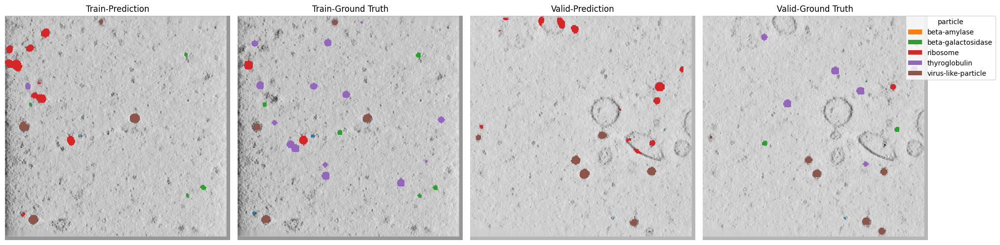

Train-nshuffle-Epoch: 42, Loss: 4.81802398763273: 100%|██████████| 460/460 [00:20<00:00, 22.27it/s]  


EPOCH: 42, TRAIN_SCORE: 0.003312130537535678


Valid-Epoch: 42, Loss: 3.5589939086981444: 100%|██████████| 184/184 [00:08<00:00, 21.62it/s]


EPOCH: 42, VALID_SCORE: 0.0037036706258188473


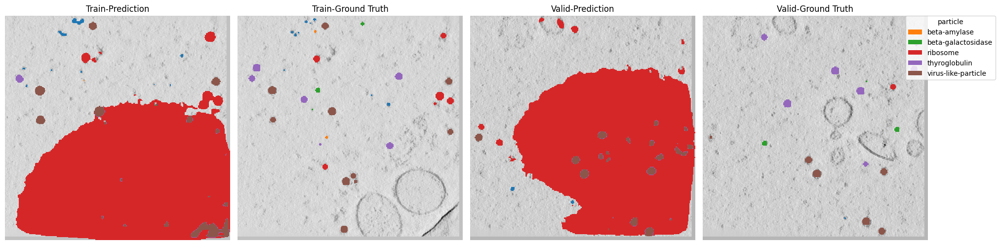

Train-Epoch: 43, Loss: 0.30850932141158566: 100%|██████████| 460/460 [00:50<00:00,  9.07it/s]
Train-nshuffle-Epoch: 43, Loss: 2.1169376425121142: 100%|██████████| 460/460 [00:19<00:00, 23.25it/s]


EPOCH: 43, TRAIN_SCORE: 0.009836859973375352


Valid-Epoch: 43, Loss: 1.8338267131020194: 100%|██████████| 184/184 [00:08<00:00, 21.85it/s]


EPOCH: 43, VALID_SCORE: 0.0035907906780257696


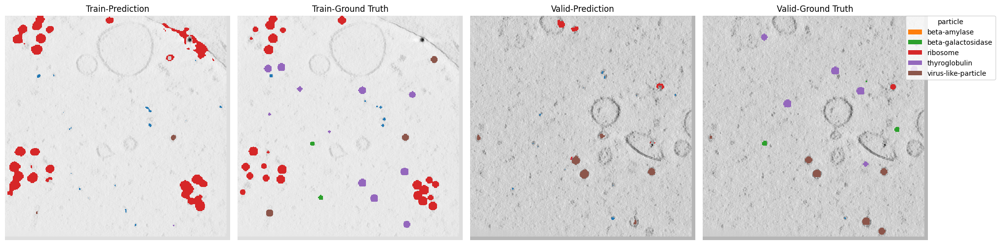

Train-Epoch: 44, Loss: 0.2843610581263657: 100%|██████████| 460/460 [00:51<00:00,  8.90it/s] 
Train-nshuffle-Epoch: 44, Loss: 1.3776815806394038: 100%|██████████| 460/460 [00:20<00:00, 22.77it/s]


EPOCH: 44, TRAIN_SCORE: 0.0041909486895533405


Valid-Epoch: 44, Loss: 1.440181180672801: 100%|██████████| 184/184 [00:08<00:00, 22.20it/s] 


EPOCH: 44, VALID_SCORE: 0.0014908357449793916


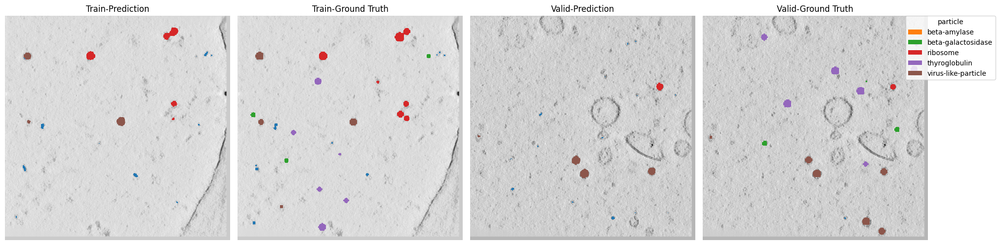

Train-Epoch: 45, Loss: 0.3234217810323057: 100%|██████████| 460/460 [00:51<00:00,  8.87it/s] 
Train-nshuffle-Epoch: 45, Loss: 1.0201764473772568: 100%|██████████| 460/460 [00:20<00:00, 22.87it/s]


EPOCH: 45, TRAIN_SCORE: 0.0015811139345184668


Valid-Epoch: 45, Loss: 1.1348366282637352: 100%|██████████| 184/184 [00:08<00:00, 21.77it/s]


EPOCH: 45, VALID_SCORE: 0.002999470681644415


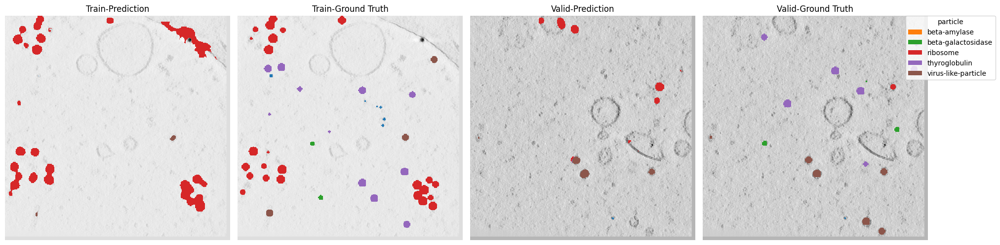

Train-Epoch: 46, Loss: 0.3096252439108313: 100%|██████████| 460/460 [00:51<00:00,  8.94it/s] 
Train-nshuffle-Epoch: 46, Loss: 0.7978729654427456: 100%|██████████| 460/460 [00:19<00:00, 23.21it/s]


EPOCH: 46, TRAIN_SCORE: 0.003492722404074905


Valid-Epoch: 46, Loss: 0.9023011733534867: 100%|██████████| 184/184 [00:08<00:00, 21.67it/s]


EPOCH: 46, VALID_SCORE: 0.008832311746884968


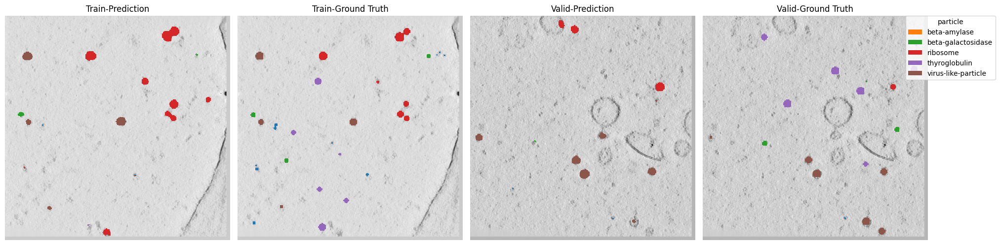

Train-Epoch: 47, Loss: 0.2788542813297523: 100%|██████████| 460/460 [00:53<00:00,  8.68it/s] 
Train-nshuffle-Epoch: 47, Loss: 0.9934776106120452: 100%|██████████| 460/460 [00:20<00:00, 22.69it/s]


EPOCH: 47, TRAIN_SCORE: 0.006873082813798309


Valid-Epoch: 47, Loss: 0.9638490064636521: 100%|██████████| 184/184 [00:08<00:00, 22.80it/s]


EPOCH: 47, VALID_SCORE: 0.002016527618520422


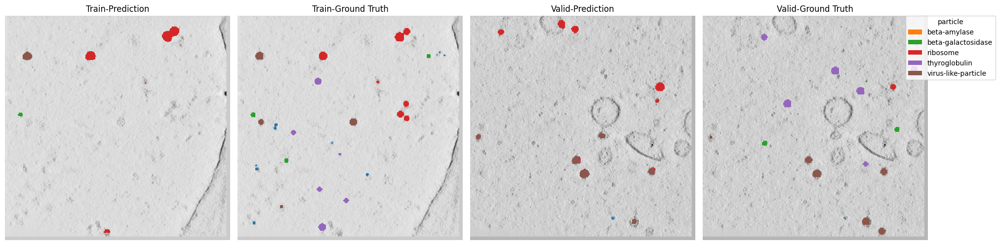

Train-Epoch: 48, Loss: 0.2746867234165699: 100%|██████████| 460/460 [00:51<00:00,  8.86it/s] 
Train-nshuffle-Epoch: 48, Loss: 0.47367224179451234: 100%|██████████| 460/460 [00:20<00:00, 22.66it/s]


EPOCH: 48, TRAIN_SCORE: 0.004299735089579236


Valid-Epoch: 48, Loss: 0.920545144593748: 100%|██████████| 184/184 [00:08<00:00, 21.59it/s] 


EPOCH: 48, VALID_SCORE: 0.012282869449839934


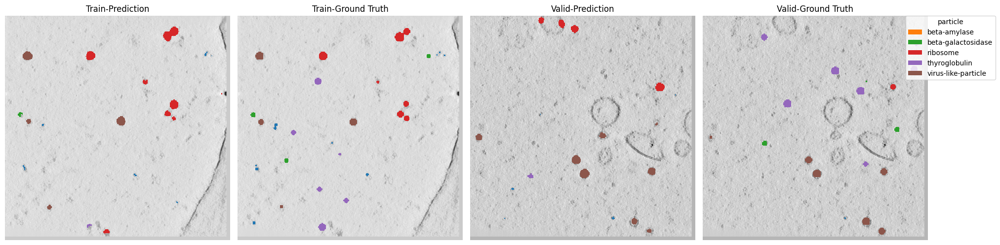

Train-Epoch: 49, Loss: 0.22202925970853793: 100%|██████████| 460/460 [00:52<00:00,  8.79it/s]
Train-nshuffle-Epoch: 49, Loss: 0.45488097886757356: 100%|██████████| 460/460 [00:20<00:00, 22.83it/s]


EPOCH: 49, TRAIN_SCORE: 0.0040269015347891264


Valid-Epoch: 49, Loss: 0.81578604184577: 100%|██████████| 184/184 [00:08<00:00, 22.44it/s]  


EPOCH: 49, VALID_SCORE: 0.005645369234495746


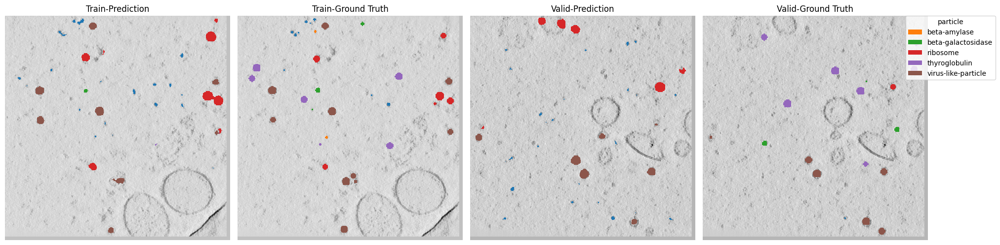

In [7]:
optimizer = torch.optim.AdamW(model.parameters(), lr=5e-4)
criterion = nn.CrossEntropyLoss(
    weight=torch.tensor([0.5, 32, 32, 32, 32, 32, 32]).to("cuda")
)
seg_loss = SegmentationLoss(criterion)
padf = PadToSize(CFG.resolution)

best_model = None
best_score = 0
batch_size = 4

for epoch in range(50):
    train_loss = []
    train_nshuffle_loss = []
    valid_loss = []

    train_original_tomogram = defaultdict(list)
    train_pred_tomogram = defaultdict(list)
    train_gt_tomogram = defaultdict(list)

    train_nshuffle_original_tomogram = defaultdict(list)
    train_nshuffle_pred_tomogram = defaultdict(list)
    train_nshuffle_gt_tomogram = defaultdict(list)

    valid_original_tomogram = defaultdict(list)
    valid_pred_tomogram = defaultdict(list)
    valid_gt_tomogram = defaultdict(list)

    model.train()
    tq = tqdm(range(len(train_loader) * normalized_tomogram.shape[0]))
    for data in train_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"].to("cuda")
        segmentation_map = data["segmentation_map"].to("cuda").long()

        train_original_tomogram[exp_name] = (
            padf(tomogram).squeeze().cpu().detach().numpy()
        )

        random_index = torch.randperm(tomogram.shape[1])

        for i in random_index:
            optimizer.zero_grad()
            input_ = tomogram[:, i].unsqueeze(0)
            gt = segmentation_map[:, i]

            input_ = padf(input_)
            gt = padf(gt)
            input_, gt = aug(input_, gt)
            output = model(input_)
            loss = seg_loss(output, gt)
            loss.backward()
            optimizer.step()

            train_loss.append(loss.item())
            tq.set_description(f"Train-Epoch: {epoch}, Loss: {np.mean(train_loss)}")
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            train_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            train_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()
    train_exp_name = exp_name

    ######################################## train-nshuffle #########################################
    model.eval()
    tq = tqdm(range(len(train_nshuffle_loader) * normalized_tomogram.shape[0]))
    for data in train_nshuffle_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"].to("cuda")
        segmentation_map = data["segmentation_map"].to("cuda").long()

        train_nshuffle_original_tomogram[exp_name] = (
            padf(tomogram).squeeze().cpu().detach().numpy()
        )

        for i in range(tomogram.shape[1]):
            input_ = tomogram[:, i].unsqueeze(0)
            gt = segmentation_map[:, i]

            input_ = padf(input_)
            gt = padf(gt)
            output = model(input_)
            loss = seg_loss(output, gt)

            train_nshuffle_loss.append(loss.item())
            tq.set_description(
                f"Train-nshuffle-Epoch: {epoch}, Loss: {np.mean(train_nshuffle_loss)}"
            )
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            train_nshuffle_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            train_nshuffle_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()

    train_score_ = visualize_epoch_results(
        train_nshuffle_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
    )
    print(f"EPOCH: {epoch}, TRAIN_SCORE: {train_score_}")

    ############################################# valid #############################################

    model.eval()
    tq = tqdm(range(len(valid_loader) * normalized_tomogram.shape[0]))
    for data in valid_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"].to("cuda")
        segmentation_map = data["segmentation_map"].to("cuda").long()

        valid_original_tomogram[exp_name] = (
            padf(tomogram).squeeze().cpu().detach().numpy()
        )

        for i in range(tomogram.shape[1]):
            input_ = tomogram[:, i].unsqueeze(0)
            gt = segmentation_map[:, i]

            input_ = padf(input_)
            gt = padf(gt)
            output = model(input_)
            loss = seg_loss(output, gt)

            valid_loss.append(loss.item())
            tq.set_description(f"Valid-Epoch: {epoch}, Loss: {np.mean(valid_loss)}")
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            valid_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            valid_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()
    valid_exp_name = exp_name

    valid_score_ = visualize_epoch_results(
        valid_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
    )

    print(f"EPOCH: {epoch}, VALID_SCORE: {valid_score_}")

    if valid_score_ > best_score:
        best_score = valid_score_
        best_model = model
        torch.save(model.state_dict(), f"best_model.pth")

    # 描画
    index = 30
    plt.figure(figsize=(20, 5))

    # Train-Pred-Plot
    ax = plt.subplot(1, 4, 1)
    pred = train_nshuffle_pred_tomogram[train_exp_name][index][0].argmax(0)
    plot_with_colormap(
        pred,
        "Train-Prediction",
        train_nshuffle_original_tomogram[train_exp_name][index],
    )

    # Train-GT-Plot
    ax = plt.subplot(1, 4, 2)
    gt = train_nshuffle_gt_tomogram[train_exp_name][index][0]
    plot_with_colormap(
        gt,
        "Train-Ground Truth",
        train_nshuffle_original_tomogram[train_exp_name][index],
    )

    # Valid-Pred-Plot
    ax = plt.subplot(1, 4, 3)
    pred = valid_pred_tomogram[valid_exp_name][index][0].argmax(0)
    plot_with_colormap(
        pred, "Valid-Prediction", valid_original_tomogram[valid_exp_name][index]
    )

    # Valid-GT-Plot
    ax = plt.subplot(1, 4, 4)
    gt = valid_gt_tomogram[valid_exp_name][index][0]
    plot_with_colormap(
        gt, "Valid-Ground Truth", valid_original_tomogram[valid_exp_name][index]
    )

    # 凡例を追加
    legend_elements = [
        Patch(facecolor=colors[i], label=CFG.particles_name[i])
        for i in range(1, num_classes)
    ]
    plt.legend(
        handles=legend_elements,
        loc="upper right",
        title="particle",
        bbox_to_anchor=(1.3, 1),  # 凡例を右上に配置
        borderaxespad=0,
    )

    plt.tight_layout()
    plt.show()

# save_images(
#     train_gt_tomogram=train_gt_tomogram,
#     train_pred_tomogram=train_pred_tomogram,
#     valid_gt_tomogram=valid_gt_tomogram,
#     valid_pred_tomogram=valid_pred_tomogram,
#     save_dir="images",
#     epoch=epoch,
# )